In [17]:
import sys
sys.path.append("..")
from ProbabilisticParcellation.util import *
import ProbabilisticParcellation.hierarchical_clustering as cl
import ProbabilisticParcellation.similarity_colormap as cm
from Functional_Fusion.dataset import *
import matplotlib.pyplot as plt
import string

base_dir = '/Volumes/diedrichsen_data$/data/FunctionalFusion'
if not Path(base_dir).exists():
    base_dir = '/srv/diedrichsen/data/FunctionalFusion'
if not Path(base_dir).exists():
    base_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/'
if not Path(base_dir).exists():
    raise (NameError('Could not find base_dir'))
    

## Load parcellation

In [18]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_best(mname)



## Similarity structure across datasets

### Datasets:
- MDTB
  - sc1 [Dataset 1]
  - sc2 [Dataset 2]
- Pontine [Dataset 3]
- Nishimoto 
  - 01 (Training) [Dataset 4]
  - 02 (Testing) [Dataset 5]
- IBC
    - archi [Dataset 6]
    - clips4 [Dataset 7]
    - enumeration [Dataet 8]
    - hcp1 [Dataset 9]
    - hcp2 [Dataset 10]
    - lyon1 [Dataset 11]
    - lyon2 [Dataset 12]
    - mathlang [Dataset 13]
    - mtt1 [Dataset 14]
    - mtt2 [Dataset 15]
    - preference [Dataset 16]
    - rsvplanguage [Dataset 17]
    - spatialnavigation [Dataset 18]
    - tom [Dataset 19]
- Working Memory
  - 01 (Working Memory) [Dataset 20]
  - 02 (Force Speed) [Dataset 21]
- Demand [Dataset 22]
- Somatotopic [Dataset 23]

<Figure size 2000x2000 with 0 Axes>

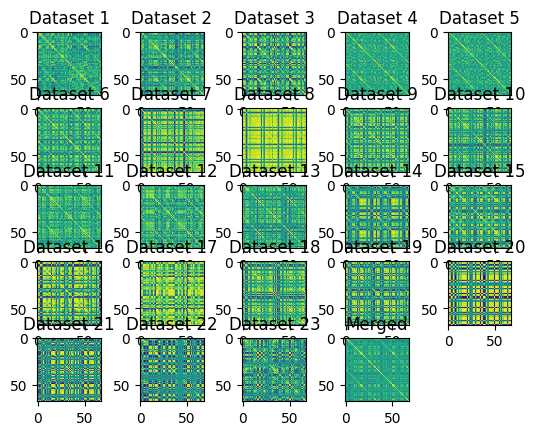

In [19]:
plt.figure(figsize=(20,20))
w_cos_sim,_,_ = cl.parcel_similarity(model,plot=True,sym=False)


## Cluster in groups

<Figure size 1400x500 with 0 Axes>

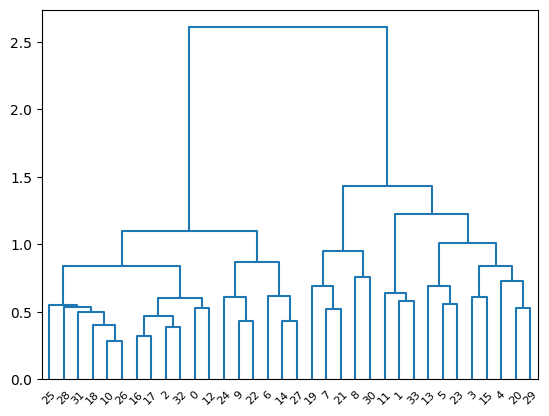

In [20]:
num_clusters = 5

plt.figure(figsize=(14,5))
sym=True
w_cos_sym,_,_ = cl.parcel_similarity(model,plot=False,sym=sym)
labels,clusters,leaves = cl.agglomative_clustering(w_cos_sym,sym=sym,method='ward',num_clusters=num_clusters)

## Make colormap

In [21]:
W = cm.calc_mds(w_cos_sim,center=True)
V=np.array([[-0.3,-0.6,1],[1,-.6,-.7],[1,1,1]]).T
V=cm.make_orthonormal(V)
m = np.array([0.65,0.65,0.65])
l = np.array([1,1,1])
# cmap = cm.colormap_mds(w_cos_sim,target=None,clusters=clusters,gamma=0.3)
cmap = cm.colormap_mds(W,target=(m,l,V),clusters=clusters,gamma=0.1)



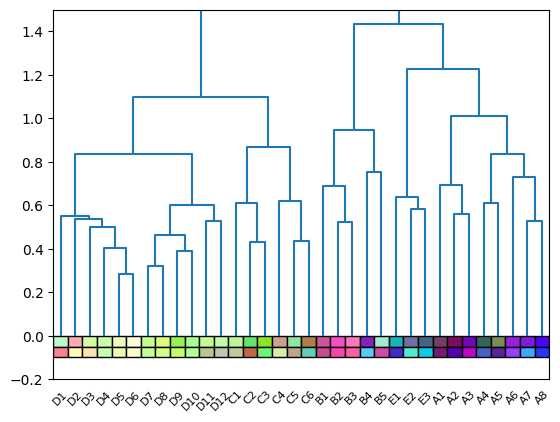

In [22]:
# Plot the clustering with the color map
labels,clusters,leaves = cl.agglomative_clustering(w_cos_sym,sym=sym,cmap=cmap,method='ward',num_clusters=num_clusters)

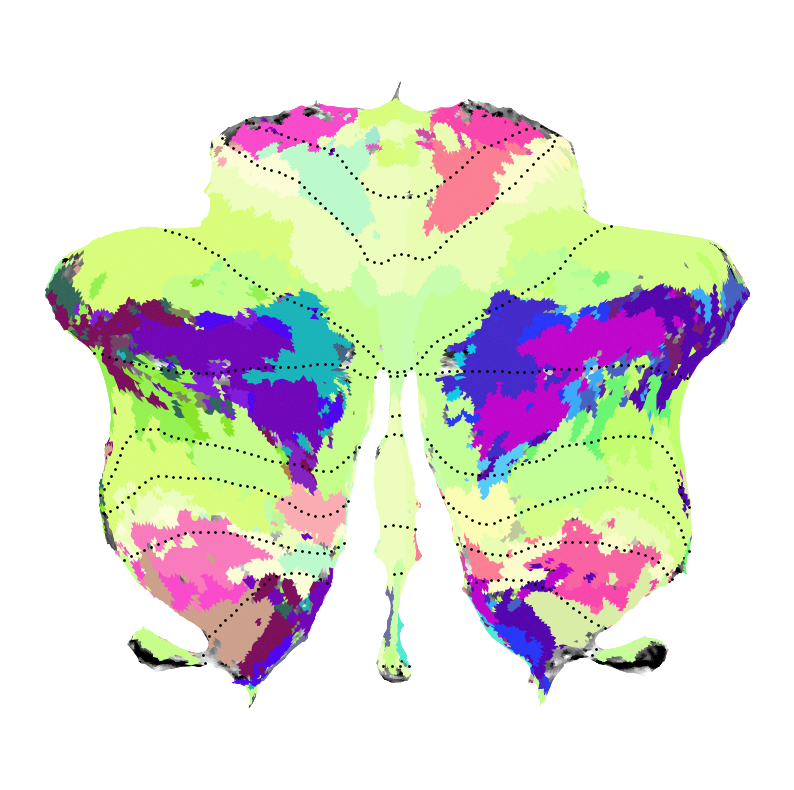

In [23]:
# Save parcellation plot
Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

figsize = [10, 10]
fig = plt.figure(figsize=figsize)
plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='matplotlib')
# ax.show()
figure_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/figures'
plt.savefig(fname=f'{figure_dir}/{fileparts[-1]}.png')


## Task Profiles

In [24]:
figsize = [10, 10]
fig = plt.figure(figsize=figsize)
ax = plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='plotly')
ax.show()

<Figure size 1000x1000 with 0 Axes>

In [25]:
# for each parcel, get the highest scoring task
profiles, conditions, datasets = cl.get_profiles(model=model,info=info)
datasets = info.datasets.strip("'[").strip("]'").split("' '")


AttributeError: module 'ProbabilisticParcellation.hierarchical_clustering' has no attribute 'get_profiles'

In [ ]:
# Collect parcel profile for each task
label_profile = {}
n_highest = 2
for l,label in enumerate(labels):
    if l != 0:
        parcel_no = labels.tolist().index(label)-1
        profile = cl.show_parcel_profile(parcel_no, profiles, conditions, datasets, show_ds='all', ncond=1, print=False)
        highest_conditions = ['{}:{}'.format(datasets[p][:2], ' & '.join(prof[:n_highest])) for p,prof in enumerate(profile)]
        label_profile[label]=highest_conditions

labels_alpha = sorted(label_profile.keys())


## A CLuster Profiles

In [ ]:

cluster = 'A'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


A1L ['MD:CheckerBoard & VideoKnots', 'Po:rest & romance_movie', 'Ni:CalcEasy & AnimalVoice', 'IB:audio_left_hand & enumeration_response_num_2', 'WM:LM & HL', 'De:nback_H_house  & switch_E_face ', 'So:glutes  & hand_left ']
A1R ['MD:VerbGen & Math', 'Po:rest & romance_movie', 'Ni:CountDot & CalcEasy', 'IB:triangle_intention & audio_left_hand', 'WM:LM & HL', 'De:nback_H_house  & switch_H_face ', 'So:glutes  & foot_left ']
A2L ['MD:SpatialNavigation & Verbal2Back', 'Po:semantic_prediction & romance_movie', 'Ni:CalcEasy & CalcHard', 'IB:foot_right & audio_sentence', 'WM:LL & L6B_encode ', 'De:nback_H_face  & stop_E_face', 'So:foot_right  & glutes ']
A2R ['MD:VerbGen & ToM', 'Po:theory_of_mind & semantic_prediction', 'Ni:CalcEasy & CountDot', 'IB:foot_right & finger_right', 'WM:LM & ML', 'De:stop_E_face & nback_H_face ', 'So:foot_right  & foot_left ']
A3L ['MD:VisualSearchMed & VideoKnots', 'Po:n_back & romance_movie', 'Ni:CalcEasy & CountDot', 'IB:object_grasp & mental', 'WM:LL & L4F_retri

## B CLuster Profiles

In [ ]:

cluster = 'B'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


B1L ['MD:VideoKnots & VisualSearchSmall', 'Po:finger_sequence & romance_movie', 'Ni:Clock & AnimalPhoto', 'IB:audio_sentence & foot_right', 'WM:LL & L4F_retriev', 'De:switch_H_house  & stop_E_face', 'So:hand_right  & hand_left ']
B1R ['MD:Math & VideoKnots', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & Clock', 'IB:audio_sentence & foot_right', 'WM:LM & ML', 'De:switch_H_house  & stop_E_face', 'So:hand_right  & hand_left ']
B2L ['MD:FingerSeq & FingerSimple', 'Po:visual_search & theory_of_mind', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:L4F_retriev & LL', 'De:nback_H_face  & switch_H_house ', 'So:tongue  & glutes ']
B2R ['MD:FingerSeq & IntervalTiming', 'Po:visual_search & theory_of_mind', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:ML & L4F_retriev', 'De:nback_H_face  & stop_E_face', 'So:hand_left  & tongue ']
B3L ['MD:VideoAct & FingerSeq', 'Po:romance_movie & rest', 'Ni:Ca

## C Cluster Profiles

In [ ]:

cluster = 'C'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


C1L ['MD:MotorImagery & SpatialNavigation', 'Po:n_back & semantic_prediction', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_3 & enumeration_response_num_1', 'WM:ML & LH', 'De:switch_H_house  & nback_H_face ', 'So:tongue  & foot_right ']
C1R ['MD:MotorImagery & SpatialNavigation', 'Po:theory_of_mind & n_back', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_1 & enumeration_response_num_3', 'WM:ML & L6F_retriev', 'De:switch_H_house  & switch_H_face ', 'So:tongue  & foot_right ']
C2L ['MD:FingerSimple & FingerSeq', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalPhoto', 'IB:vstm_response_num_4 & vstm_response_num_5', 'WM:HL & LM', 'De:switch_H_house  & nback_E_house ', 'So:foot_right  & foot_left ']
C2R ['MD:FingerSimple & FingerSeq', 'Po:romance_movie & rest', 'Ni:CategoryFluency  & CalcHard', 'IB:vstm_response_num_4 & vstm_response_num_5', 'WM:HL & LL', 'De:nback_H_face  & stop_E_face', 'So:foot_right  & foot_left ']
C3L ['MD:Verbal2Back & Object0Back', 'Po:romance_movi

## D Cluster Profiles

In [ ]:
cluster = 'D'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


D10L ['MD:Verbal2Back & VisualSearchSmall', 'Po:romance_movie & rest', 'Ni:AnimalPhoto & Clock', 'IB:left_foot & vstm_response_num_4', 'WM:ML & L6B_encode ', 'De:switch_H_house  & switch_E_face ', 'So:glutes  & tongue ']
D10R ['MD:Verbal2Back & VerbGen', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & ComparePeople', 'IB:lower_right & left_foot', 'WM:ML & LH', 'De:switch_H_house  & nback_H_face ', 'So:glutes  & tongue ']
D11L ['MD:FingerSeq & SpatialNavigation', 'Po:romance_movie & rest', 'Ni:CountTone & AnimalVoice', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:L4F_retriev & ML', 'De:nback_H_face  & switch_H_face ', 'So:tongue  & hand_left ']
D11R ['MD:FingerSeq & VerbGen', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & AnimalVoice', 'IB:enumeration_response_num_2 & vstm_response_num_4', 'WM:L4F_retriev & ML', 'De:nback_H_face  & switch_H_face ', 'So:foot_left  & tongue ']
D12L ['MD:FingerSeq & VisualSearchLarge', 'Po:romance_movie & rest'

## E Cluster Profiles

In [ ]:
cluster = 'E'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


E1L ['MD:ToM & Verbal2Back', 'Po:action_observation_knots & flexion_extension', 'Ni:CountTone & CalcEasy', 'IB:vertical_checkerboard & face_trusty', 'WM:ML & LM', 'De:nback_E_house  & nback_H_face ', 'So:foot_left  & hand_right ']
E1R ['MD:ToM & VerbGen', 'Po:theory_of_mind & action_observation_knots', 'Ni:CategoryFluency  & ComparePeople', 'IB:vertical_checkerboard & 0back_face', 'WM:LM & ML', 'De:stop_E_face & stop_E_house ', 'So:foot_left  & foot_right ']
E2L ['MD:ToM & VideoKnots', 'Po:romance_movie & finger_sequence', 'Ni:AnimalPhoto & CategoryFluency ', 'IB:enumeration_response_num_2 & fixation_right', 'WM:L6F_encode  & ML', 'De:switch_H_face  & switch_H_house ', 'So:foot_left  & hand_right ']
E2R ['MD:ToM & VideoKnots', 'Po:romance_movie & theory_of_mind', 'Ni:AnimalPhoto & CategoryFluency ', 'IB:punishment & foot_right', 'WM:ML & L6F_encode ', 'De:switch_H_face  & nback_E_face ', 'So:foot_right  & foot_left ']
E3L ['MD:Verbal2Back & Object2Back', 'Po:action_observation_knots & 

## Lateralization Map

<Figure size 1000x1000 with 0 Axes>

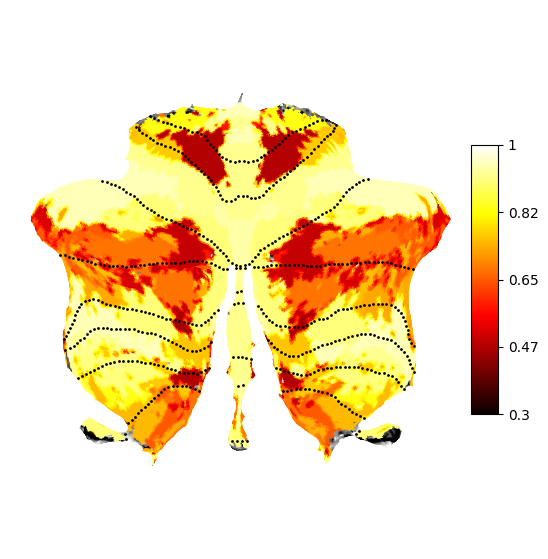

In [ ]:
figsize = [10, 10]
fig = plt.figure(figsize=figsize)
sym_score = cl.make_asymmetry_map(mname, cmap='hot', cscale=[0.3, 1])

In [ ]:
lateralization = {}
for label, score in zip(labels, sym_score):
    lateralization[label] = score

if lateralization['D11L'] != lateralization['D11R']:
    raise(AssertionError('Left and right parcels must have the same similarity scores'))
    

### Import model-clustered Map

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-10'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_fit(mname)

# Save parcellation plot
Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

figsize = [10, 10]
fig = plt.figure(figsize=figsize)
plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='matplotlib')

n_clusters = len(np.unique(parcel))
if sym:
    n_clusters = n_clusters/2

plt.title(f'{n_clusters} WTA Clusters')

figure_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/figures'
plt.savefig(fname=f'{figure_dir}/{fileparts[-1]}.png')


FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/diedrichsen_data$/data/Cerebellum/ProbabilisticParcellationModel/Models//Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-10.tsv'

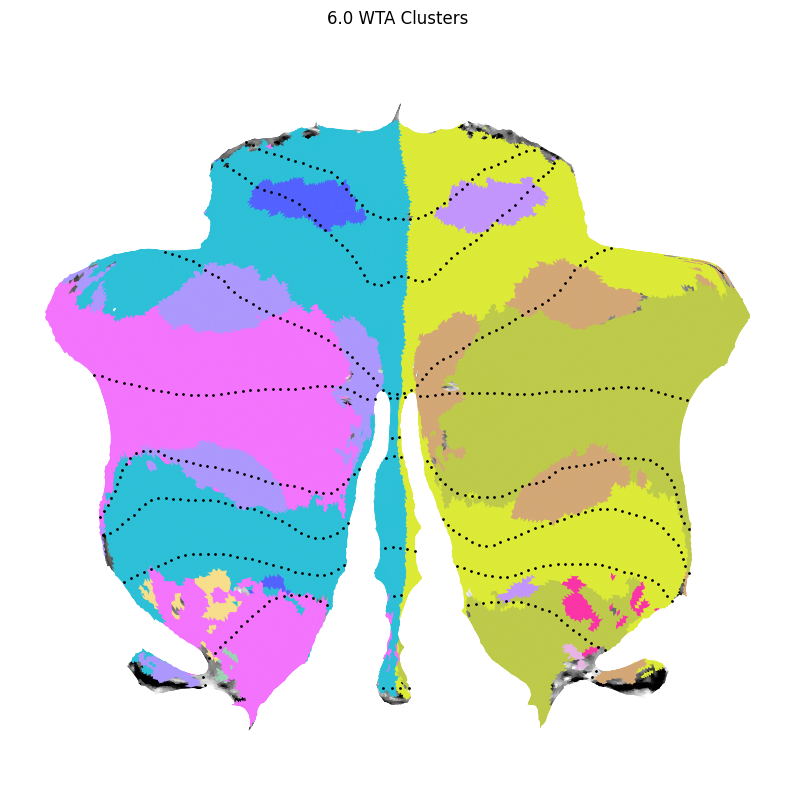

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-20'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_fit(mname)

# Save parcellation plot
Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

figsize = [10, 10]
fig = plt.figure(figsize=figsize)
plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='matplotlib')

n_clusters = len(np.unique(parcel))

plt.title(f'{n_clusters} WTA Clusters')

figure_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/figures'
plt.savefig(fname=f'{figure_dir}/{fileparts[-1]}.png')


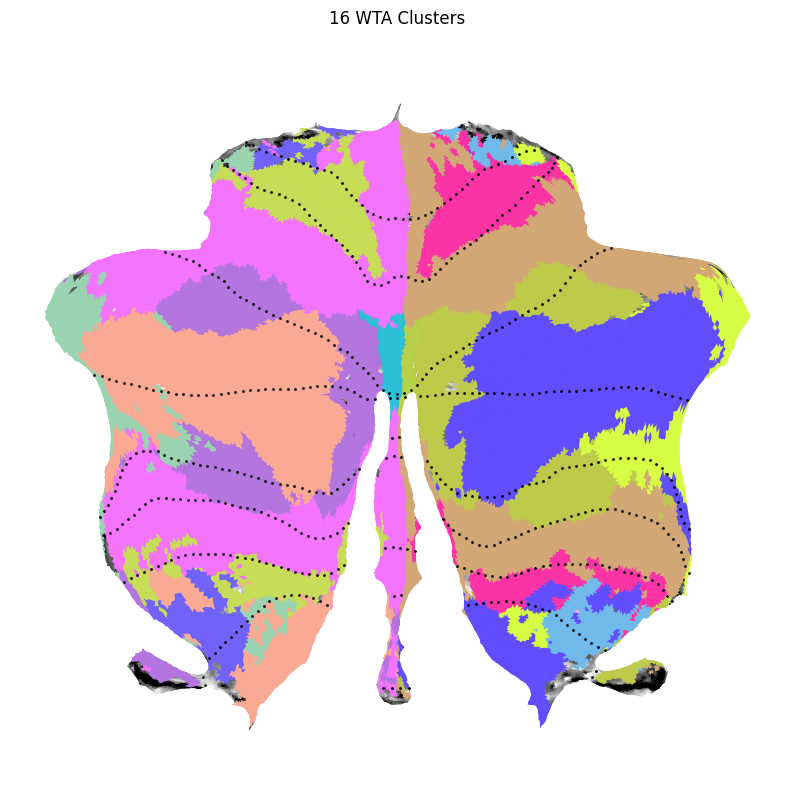

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-22'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_fit(mname)

# Save parcellation plot
Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

figsize = [10, 10]
fig = plt.figure(figsize=figsize)
plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='matplotlib')

n_clusters = len(np.unique(parcel))
plt.title(f'{n_clusters} WTA Clusters')

figure_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/figures'
plt.savefig(fname=f'{figure_dir}/{fileparts[-1]}.png')


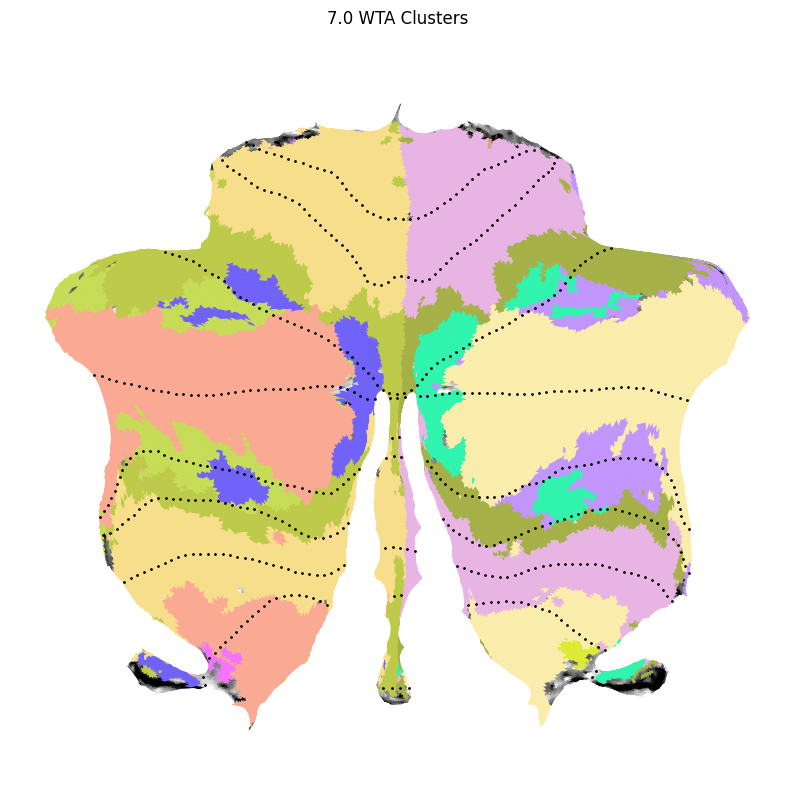

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-26'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_fit(mname)

# Save parcellation plot
Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

figsize = [10, 10]
fig = plt.figure(figsize=figsize)
plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='matplotlib')

n_clusters = len(np.unique(parcel))
if sym:
    n_clusters = n_clusters/2

plt.title(f'{n_clusters} WTA Clusters')

figure_dir = '/Users/callithrix/Documents/Projects/Functional_Fusion/figures'
plt.savefig(fname=f'{figure_dir}/{fileparts[-1]}.png')


## Task Profiles of model-based Clusters

In [ ]:
# Import fine and coarse model
cluster_by=20
mname_fine = 'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68'
mname_coarse = f'Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-{cluster_by}'

# Import fine model
fileparts = mname_fine.split('/')
split_mn = fileparts[-1].split('_')
finfo,fmodel = load_batch_best(mname_fine)
fine_probabilities = pt.softmax(fmodel.arrange.logpi,dim=0)

# Import coarse model
fileparts = mname_coarse.split('/')
split_mn = fileparts[-1].split('_')
cinfo,cmodel = load_batch_best(mname_coarse)
coarse_probabilities = pt.softmax(cmodel.arrange.logpi,dim=0)

mapping = cl.map_fine2coarse(fine_probabilities, coarse_probabilities)

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68_merged_K-10'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_fit(mname)

Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

ax = plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=labels,
                    render='plotly')
ax.show()



In [ ]:
model_labels = labels[1:]
map_all = np.hstack((mapping,mapping))

cluster_names = list(string.ascii_uppercase)[:len(np.unique(map_all))]

for c,cluster in enumerate(np.unique(map_all)):
    new_labels = model_labels[map_all==cluster]
    new_labels = [ f'{cluster_names[c]}{lab[1:]}' for lab in new_labels]
    model_labels[map_all==cluster] = new_labels


model_labels = np.insert(model_labels, 0, '0', axis=0)

print(model_labels)

['0' 'F11L' 'D2L' 'F9L' 'B4L' 'A6L' 'D2L' 'G4L' 'C2L' 'D4L' 'D2L' 'H5L'
 'D1L' 'H12L' 'D1L' 'A5L' 'B5L' 'F7L' 'H8L' 'H4L' 'A1L' 'D7L' 'C3L' 'F3L'
 'D3L' 'H1L' 'E1L' 'E6L' 'A6L' 'H2L' 'D8L' 'H5L' 'H3L' 'F10L' 'I3L' 'F11R'
 'D2R' 'F9R' 'B4R' 'A6R' 'D2R' 'G4R' 'C2R' 'D4R' 'D2R' 'H5R' 'D1R' 'H12R'
 'D1R' 'A5R' 'B5R' 'F7R' 'H8R' 'H4R' 'A1R' 'D7R' 'C3R' 'F3R' 'D3R' 'H1R'
 'E1R' 'E6R' 'A6R' 'H2R' 'D8R' 'H5R' 'H3R' 'F10R' 'I3R']


In [ ]:
# Collect parcel profile for each task
label_profile = {}
n_highest = 2
for l,label in enumerate(model_labels):
    if l != 0:
        parcel_no = model_labels.tolist().index(label)-1
        profile = cl.show_parcel_profile(parcel_no, profiles, conditions, datasets, show_ds='all', ncond=1, print=False)
        highest_conditions = ['{}:{}'.format(datasets[p][:2], ' & '.join(prof[:n_highest])) for p,prof in enumerate(profile)]
        label_profile[label]=highest_conditions

labels_alpha = sorted(label_profile.keys())

In [ ]:
mname = '/Models_03/sym_MdPoNiIbWmDeSo_space-MNISymC3_K-68'
fileparts = mname.split('/')
split_mn = fileparts[-1].split('_')
info,model = load_batch_best(mname)

Prop = np.array(model.marginal_prob())
parcel = Prop.argmax(axis=0)+1
atlas = split_mn[2][6:]

ax = plot_data_flat(parcel,atlas,cmap = cmap,
                    dtype='label',
                    labels=model_labels,
                    render='plotly')
ax.show()



In [ ]:

cluster = 'A'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


A1L ['MD:VideoKnots & VisualSearchSmall', 'Po:finger_sequence & romance_movie', 'Ni:Clock & AnimalPhoto', 'IB:audio_sentence & foot_right', 'WM:LL & L4F_retriev', 'De:switch_H_house  & stop_E_face', 'So:hand_right  & hand_left ']
A1R ['MD:Math & VideoKnots', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & Clock', 'IB:audio_sentence & foot_right', 'WM:LM & ML', 'De:switch_H_house  & stop_E_face', 'So:hand_right  & hand_left ']
A5L ['MD:FingerSeq & FingerSimple', 'Po:romance_movie & rest', 'Ni:CalcHard & CalcEasy', 'IB:speech & false_belief_video', 'WM:LH & L6F_encode ', 'De:nback_H_face  & switch_H_house ', 'So:tongue  & foot_right ']
A5R ['MD:FingerSeq & VerbGen', 'Po:romance_movie & rest', 'Ni:CalcHard & CalcEasy', 'IB:vstm_response_num_2 & speech', 'WM:ML & LM', 'De:nback_H_face  & stop_E_face', 'So:tongue  & hand_left ']
A6L ['MD:Verbal2Back & Object2Back', 'Po:action_observation_knots & finger_sequence', 'Ni:CountTone & CalcEasy', 'IB:vstm_response_num_3 & vstm_response

In [ ]:

cluster = 'B'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


B4L ['MD:Verbal2Back & Object0Back', 'Po:romance_movie & rest', 'Ni:Clock & AnimalPhoto', 'IB:punishment & enumeration_response_num_4', 'WM:ML & LH', 'De:switch_E_face  & nback_E_house ', 'So:tongue  & foot_right ']
B4R ['MD:VerbGen & ToM', 'Po:theory_of_mind & n_back', 'Ni:Clock & CalcEasy', 'IB:punishment & face_gender', 'WM:ML & LH', 'De:switch_E_face  & nback_E_house ', 'So:tongue  & foot_right ']
B5L ['MD:Verbal2Back & Object2Back', 'Po:romance_movie & rest', 'Ni:AnimalVoice & CountDot', 'IB:audio_sentence & false_belief_video', 'WM:L6B_encode  & ML', 'De:stop_E_face & switch_H_house ', 'So:glutes  & foot_left ']
B5R ['MD:VerbGen & ToM', 'Po:theory_of_mind & semantic_prediction', 'Ni:AnimalVoice & CountDot', 'IB:vstm_response_num_2 & speech', 'WM:ML & L4B_encode ', 'De:stop_E_face & stop_H_face ', 'So:tongue  & foot_left ']


In [ ]:

cluster = 'C'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


C2L ['MD:FingerSeq & FingerSimple', 'Po:visual_search & theory_of_mind', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:L4F_retriev & LL', 'De:nback_H_face  & switch_H_house ', 'So:tongue  & glutes ']
C2R ['MD:FingerSeq & IntervalTiming', 'Po:visual_search & theory_of_mind', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:ML & L4F_retriev', 'De:nback_H_face  & stop_E_face', 'So:hand_left  & tongue ']
C3L ['MD:VideoAct & FingerSeq', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalVoice', 'IB:vstm_response_num_4 & vstm_response_num_5', 'WM:ML & LH', 'De:switch_H_house  & stop_E_face', 'So:hand_right  & hand_left ']
C3R ['MD:VideoAct & FingerSeq', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalVoice', 'IB:vstm_response_num_4 & left_foot', 'WM:ML & LH', 'De:stop_E_face & switch_H_house ', 'So:hand_right  & hand_left ']


In [ ]:

cluster = 'D'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


D1L ['MD:ToM & Verbal2Back', 'Po:action_observation_knots & flexion_extension', 'Ni:CountTone & CalcEasy', 'IB:vertical_checkerboard & face_trusty', 'WM:ML & LM', 'De:nback_E_house  & nback_H_face ', 'So:foot_left  & hand_right ']
D1R ['MD:ToM & VerbGen', 'Po:theory_of_mind & action_observation_knots', 'Ni:CategoryFluency  & ComparePeople', 'IB:vertical_checkerboard & 0back_face', 'WM:LM & ML', 'De:stop_E_face & stop_E_house ', 'So:foot_left  & foot_right ']
D2L ['MD:ToM & VideoKnots', 'Po:romance_movie & finger_sequence', 'Ni:AnimalPhoto & CategoryFluency ', 'IB:enumeration_response_num_2 & fixation_right', 'WM:L6F_encode  & ML', 'De:switch_H_face  & switch_H_house ', 'So:foot_left  & hand_right ']
D2R ['MD:ToM & VideoKnots', 'Po:romance_movie & theory_of_mind', 'Ni:AnimalPhoto & CategoryFluency ', 'IB:punishment & foot_right', 'WM:ML & L6F_encode ', 'De:switch_H_face  & nback_E_face ', 'So:foot_right  & foot_left ']
D3L ['MD:VisualSearchMed & VideoKnots', 'Po:n_back & romance_movie',

In [ ]:

cluster = 'E'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


E1L ['MD:FingerSeq & FingerSimple', 'Po:rest & finger_sequence', 'Ni:CalcHard & AnimalPhoto', 'IB:face & audio_sentence', 'WM:LL & LM', 'De:switch_H_house  & nback_E_house ', 'So:foot_left  & hand_left ']
E1R ['MD:FingerSeq & FingerSimple', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalPhoto', 'IB:face & audio_sentence', 'WM:LL & LM', 'De:nback_H_face  & switch_H_house ', 'So:foot_left  & hand_left ']
E6L ['MD:FingerSeq & VideoAct', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalPhoto', 'IB:vstm_response_num_2 & neutral', 'WM:ML & LH', 'De:switch_H_house  & nback_E_face ', 'So:tongue  & glutes ']
E6R ['MD:FingerSeq & FingerSimple', 'Po:romance_movie & rest', 'Ni:CalcHard & AnimalPhoto', 'IB:vstm_response_num_2 & punishment', 'WM:ML & LH', 'De:stop_E_face & nback_E_face ', 'So:tongue  & glutes ']


In [ ]:

cluster = 'F'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


F10L ['MD:Verbal2Back & VisualSearchSmall', 'Po:romance_movie & rest', 'Ni:AnimalPhoto & Clock', 'IB:left_foot & vstm_response_num_4', 'WM:ML & L6B_encode ', 'De:switch_H_house  & switch_E_face ', 'So:glutes  & tongue ']
F10R ['MD:Verbal2Back & VerbGen', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & ComparePeople', 'IB:lower_right & left_foot', 'WM:ML & LH', 'De:switch_H_house  & nback_H_face ', 'So:glutes  & tongue ']
F11L ['MD:FingerSeq & SpatialNavigation', 'Po:romance_movie & rest', 'Ni:CountTone & AnimalVoice', 'IB:enumeration_response_num_2 & enumeration_response_num_3', 'WM:L4F_retriev & ML', 'De:nback_H_face  & switch_H_face ', 'So:tongue  & hand_left ']
F11R ['MD:FingerSeq & VerbGen', 'Po:romance_movie & theory_of_mind', 'Ni:CategoryFluency  & AnimalVoice', 'IB:enumeration_response_num_2 & vstm_response_num_4', 'WM:L4F_retriev & ML', 'De:nback_H_face  & switch_H_face ', 'So:foot_left  & tongue ']
F3L ['MD:Verbal2Back & Object0Back', 'Po:romance_movie & rest', 'Ni

In [ ]:

cluster = 'G'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


G4L ['MD:VideoAct & VideoKnots', 'Po:romance_movie & rest', 'Ni:CalcHard & CalcEasy', 'IB:punishment & vstm_response_num_2', 'WM:ML & LH', 'De:switch_H_house  & nback_E_face ', 'So:hand_left  & tongue ']
G4R ['MD:VideoAct & VideoKnots', 'Po:romance_movie & semantic_prediction', 'Ni:CalcHard & AnimalVoice', 'IB:punishment & vstm_response_num_5', 'WM:ML & LH', 'De:switch_H_house  & nback_E_face ', 'So:hand_left  & hand_right ']


In [ ]:

cluster = 'H'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


H12L ['MD:FingerSeq & VisualSearchLarge', 'Po:romance_movie & rest', 'Ni:CalcEasy & CalcHard', 'IB:lower_left & enumeration_response_num_2', 'WM:L4F_retriev & HL', 'De:nback_H_face  & stop_E_face', 'So:glutes  & tongue ']
H12R ['MD:FingerSeq & VerbGen', 'Po:theory_of_mind & romance_movie', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_3 & enumeration_response_num_2', 'WM:L4F_retriev & ML', 'De:nback_H_face  & stop_E_face', 'So:glutes  & foot_right ']
H1L ['MD:MotorImagery & SpatialNavigation', 'Po:n_back & semantic_prediction', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_3 & enumeration_response_num_1', 'WM:ML & LH', 'De:switch_H_house  & nback_H_face ', 'So:tongue  & foot_right ']
H1R ['MD:MotorImagery & SpatialNavigation', 'Po:theory_of_mind & n_back', 'Ni:CalcEasy & CalcHard', 'IB:enumeration_response_num_1 & enumeration_response_num_3', 'WM:ML & L6F_retriev', 'De:switch_H_house  & switch_H_face ', 'So:tongue  & foot_right ']
H2L ['MD:VideoAct & FingerSeq', 'Po:r

In [ ]:

cluster = 'I'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


I3L ['MD:Verbal2Back & Object2Back', 'Po:action_observation_knots & finger_sequence', 'Ni:CategoryFluency  & ComparePeople', 'IB:peripheral & left_meridian', 'WM:LM & LH', 'De:switch_H_face  & switch_E_house ', 'So:hand_right  & foot_left ']
I3R ['MD:VerbGen & ToM', 'Po:theory_of_mind & action_observation_knots', 'Ni:CategoryFluency  & ComparePeople', 'IB:peripheral & left_meridian', 'WM:L6F_encode  & LM', 'De:switch_H_face  & nback_H_house ', 'So:foot_right  & glutes ']


In [ ]:

cluster = 'J'
cluster_labels = [label for label in labels_alpha if cluster in label]
for label in cluster_labels:
    print(label, label_profile[label])


In [ ]:
cluster_indices = [key[0] for key in label_profile.keys()]
print('J' in cluster_indices)
print('L' in cluster_indices)
print('L' in cluster_indices)

False
False
False
